In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import json
import re
import numpy as np

In [7]:
def read_data():
    df_prices_2 = pd.read_csv('./data/prices_round_5_day_2.csv', sep=';')
    df_prices_3 = pd.read_csv('./data/prices_round_5_day_3.csv', sep=';')
    df_prices_4 = pd.read_csv('./data/prices_round_5_day_4.csv', sep=';')
    
    df_trades_2 = pd.read_csv('./data/trades_round_5_day_2.csv', sep=';')
    df_trades_3 = pd.read_csv('./data/trades_round_5_day_3.csv', sep=';')
    df_trades_4 = pd.read_csv('./data/trades_round_5_day_4.csv', sep=';')
    df_trades_2['day'] = 2
    df_trades_3['day'] = 3
    df_trades_4['day'] = 4
    df_prices = pd.concat([df_prices_2, df_prices_3, df_prices_4])
    df_prices['timestamp'] = df_prices['timestamp'] + 1000000 * df_prices['day']
    df_trades = pd.concat([df_trades_2, df_trades_3, df_trades_4])
    df_trades['timestamp'] = df_trades['timestamp'] + 1000000 * df_trades['day']
    return df_prices, df_trades

In [8]:
df_prices, df_trades = read_data()
print('Finished reading data')

Finished reading data


In [5]:
# define constants and aliases
SQI = 'SQUID_INK'
KLP = 'KELP'
RAR = 'RAINFOREST_RESIN'

CST = 'CROISSANTS'
JAM = 'JAMS'
DJE = 'DJEMBES'
PB1 = 'PICNIC_BASKET1'
PB2 = 'PICNIC_BASKET2'

VOR = 'VOLCANIC_ROCK'
VOR_C9500 = 'VOLCANIC_ROCK_VOUCHER_9500'
VOR_C9750 = 'VOLCANIC_ROCK_VOUCHER_9750'
VOR_C10000 = 'VOLCANIC_ROCK_VOUCHER_10000'
VOR_C10250 = 'VOLCANIC_ROCK_VOUCHER_10250'
VOR_C10500 = 'VOLCANIC_ROCK_VOUCHER_10500'

MAC = 'MAGNIFICENT_MACARONS'

coupons = [VOR_C9500, VOR_C9750, VOR_C10000, VOR_C10250, VOR_C10500]
strikes = {VOR_C9500: 9500, \
            VOR_C9750: 9750, \
            VOR_C10000: 10000, \
            VOR_C10250: 10250, \
            VOR_C10500: 10500}

symbols_r1 = {SQI, KLP, RAR}
symbols_r2 = {CST, JAM, DJE, PB1, PB2}
symbols_r3 = {VOR, VOR_C9500, VOR_C9750, VOR_C10000, VOR_C10250, VOR_C10500}
vouchers = symbols_r3 - {VOR}
symbols_r4 = {MAC}
symbols = symbols_r1.union(symbols_r2).union(symbols_r3).union(symbols_r4)

position_limits = {MAC: 0, ######################## TO FIX \
                   VOR: 400, VOR_C9500: 200, VOR_C9750: 200, VOR_C10000: 200, VOR_C10250: 200, VOR_C10500: 200, \
                   CST: 250, JAM: 350, DJE: 60, PB1: 60, PB2: 100, \
                   SQI: 50, KLP: 50, RAR: 50}

In [9]:
# build a set of traders
buyers = set(df_trades['buyer'].unique())
sellers = set(df_trades['seller'].unique())

traders = buyers.union(sellers)
print(traders)

{'Caesar', 'Penelope', 'Gina', 'Charlie', 'Camilla', 'Gary', 'Pablo', 'Peter', 'Olivia', 'Paris', 'Olga'}


## Trader analysis

### Olivia
20 trades. KLP, SQI, CST. Strong signal!! (always 3 CST and 15 SQI and 15 KLP per day)

Observe that Olivia always knows the lowest and the highest prices in the day!

Best match: AriAnt

Ari believes in the power of teamwork... but somehow always ends up with the best crumbs for himself. Got some great antennae to find the best deals.

### Charlie
Very active. Seems to be the main MM for round 1 products. Also long on PB2 and a bit on PB1.

- PB1 (-5.5, +5.5) small volume
- MAC (-4.5, +4.0)
- PB2 (-3.0, +3.0)

Best match: AmirAnt

Always busy, always building. Amir builds his trading portfolio while directing traffic in the ant colony. Always anticipating, always redirecting.
No collisions on his record to this date.

### Pablo

Seems to be an unlucky trader. Short vouchers and trades many other things.

The average next-timestamp mid price change right after his bids get through:

- PB1 -4.4, ~100 per day. 
- PB2 -1.45, ~70 per day.
- KLP -0.46, ~110 per day.

And for asks:
- PB1 +1.70, ~200 per day.
- KLP +0.54, ~240 per day.
- PB2 +0.86, ~170 per day.

The patterns upon visualization are not that clean, but statistically rather significant. Worth investigating the timings?

Best match: SantiagoSpider

Keeps at least six of his eight eyes glued to the monitor at all times. Anxiously awaiting the results of his latest eye exam — worried that he’s been seeing it all wrong all along.

In [89]:
# Olga: only 1 trade, sold sth. what????
# Penelope: very active. does she love placing market bids and asks? keeps getting unfavorable deals...
# Camilla: very active. minor MM in RAR. direction very clear for most products (why?)
# Caesar: very active. makes lots of trades. makes profit either from MM or good trades
# Gary: not a lot of trades. only day 1 goods it seems. got some strong convictions at times.
# Gina: ~1200 trades. only day 1 goods. overpriced on RAR. lots of positions on the other two, majority sell orders
# Paris: many trades. on round 1 and 2 basic goods
# Peter: VOR only. not sure 

# VOR: Peter, Pablo, Caesar
# VOR vouchers: Pablo, Camilla, Penelope

# JAM: Mostly Caesar -> Camilla (have other trades)
# CST: Mostly Caesar -> Camilla
# DJE: Mostly Caesar -> Camilla

In [10]:
def extract_individual_info(df_trades):
    
    trades = {}
    for S in symbols:
        trades[S] = df_trades[df_trades['symbol'] == S]
    
    portfolios = {}
    for T in traders:
        portfolios[T] = df_trades[(df_trades['buyer'] == T) | (df_trades['seller'] == T)]
    
    return trades, portfolios

In [11]:
trades, portfolios = extract_individual_info(df_trades)
print('Extraction of \"trades\" and \"portfolios\" done')

Extraction of "trades" and "portfolios" done


----------------------

Research to follow! Let's start with some tools and preliminary probing

In [8]:
def visualize_trades(T, t_lo, t_hi):
    def get_signed_quantity(row):
        if row['buyer'] == T:
            return row['quantity']
        elif row['seller'] == T:
            return -row['quantity']
        return 0

    df = portfolios[T].copy(deep=True)
    
    df['signed_qty'] = df.apply(get_signed_quantity, axis=1)

    df = df.sort_values(by='timestamp')

    positions = (
        df.groupby('symbol', group_keys=False)
          .apply(lambda x: x.assign(position=x['signed_qty'].cumsum()))
    )

    for sym in symbols:
        sym_df = positions[(positions['symbol'] == sym) & (t_lo <= positions['timestamp']) & (positions['timestamp'] < t_hi)]
        sym_df = sym_df.sort_values(by='timestamp')
        if (sym_df.empty):
            continue
        # Create figure
        plt.figure(figsize=(9, 5))
        plt.plot(sym_df['timestamp'], sym_df['position'], linestyle='-', color='black', label='Net Position')
                 
        # Plot trade points
        buys = sym_df[sym_df['signed_qty'] > 0]
        sells = sym_df[sym_df['signed_qty'] < 0]
    
        plt.scatter(buys['timestamp'], buys['position'], color='green', label='Buy', marker='^', zorder=5)
        plt.scatter(sells['timestamp'], sells['position'], color='red', label='Sell', marker='v', zorder=5)
    
        # Annotate prices
        for _, row in buys.iterrows():
            plt.text(row['timestamp'], row['position'], f"{row['price']}", color='green', fontsize=8, ha='left', va='bottom')
        for _, row in sells.iterrows():
            plt.text(row['timestamp'], row['position'], f"{row['price']}", color='red', fontsize=8, ha='right', va='top')
        
        # Labels and legend
        plt.title(f'Net Position Over Time: {sym}')
        plt.xlabel('Timestamp')
        plt.ylabel('Net Position (Quantity)')
        plt.grid(True)
        plt.legend()
        imgname = './figures/' + T + '_day_' + str(t_lo//1000000) + '_' + sym + '.jpg'
        plt.savefig(imgname)
        print(imgname + ' saved!')

A tool to plot the prices

In [12]:
def plot_prices(S, t_lo=2000000, t_hi=5000000, ticks=1, print_to_file=False):
    prices = df_prices[(df_prices['product'] == S) & (df_prices['timestamp'] >= t_lo) & (df_prices['timestamp'] < t_hi)]
    plt.plot(prices['timestamp'][::ticks], prices['mid_price'][::ticks])
    if (print_to_file):
        imgname = './figures/' + S + '_day_' + str(t_lo//1000000) + '.jpg'
        plt.savefig(imgname)
        print(imgname + ' saved!')
    else:
        plt.show()
    plt.close()

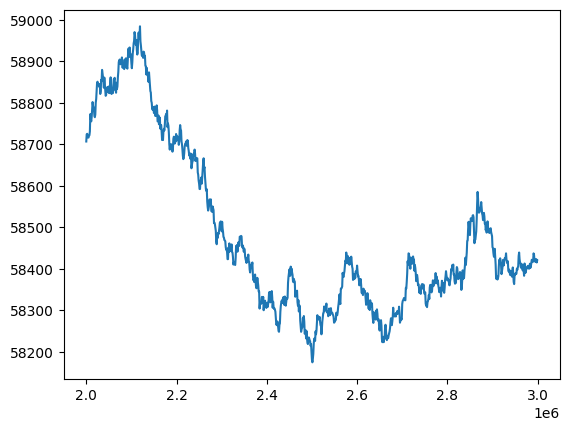

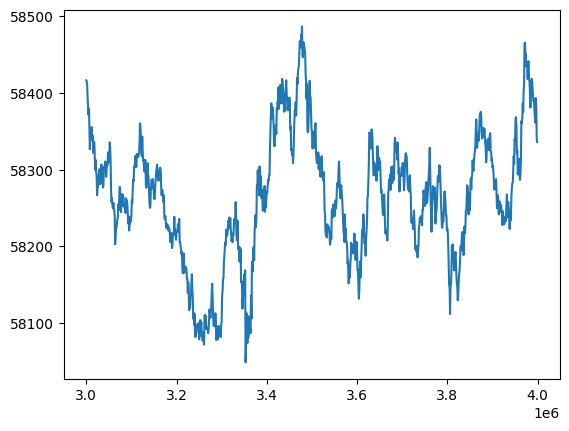

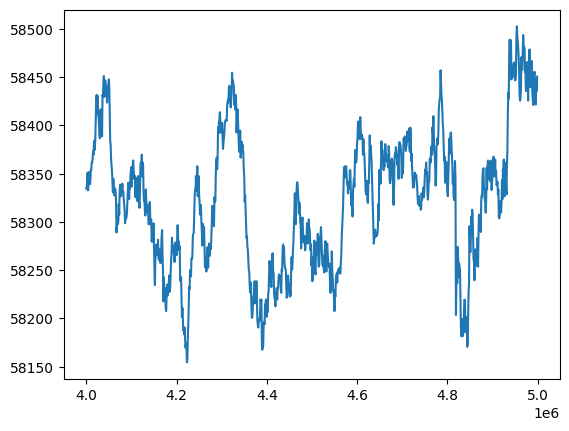

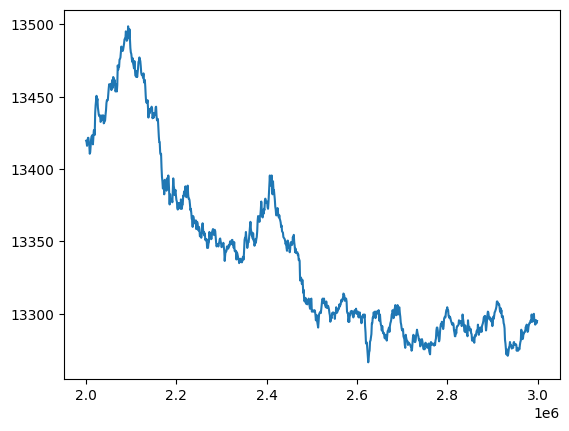

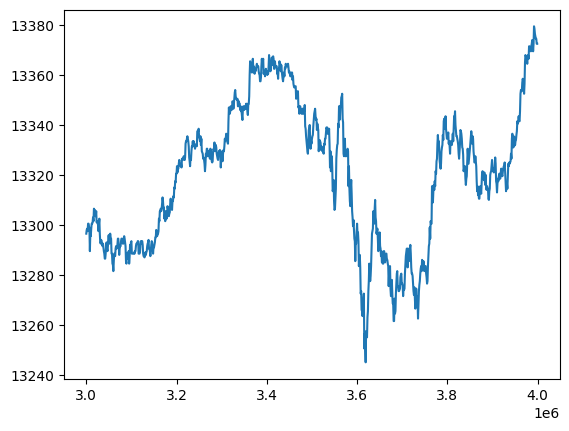

...

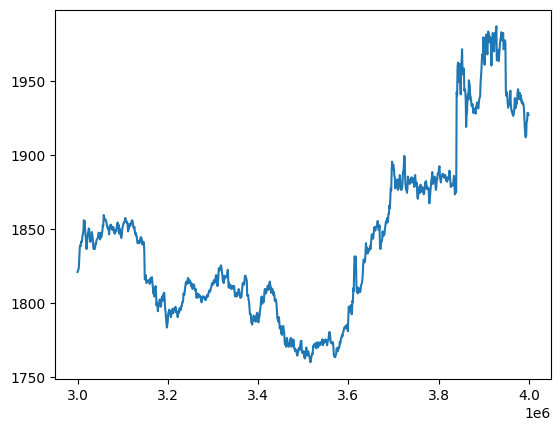

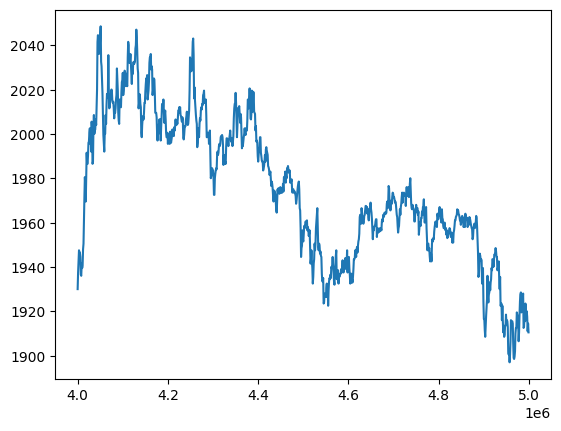

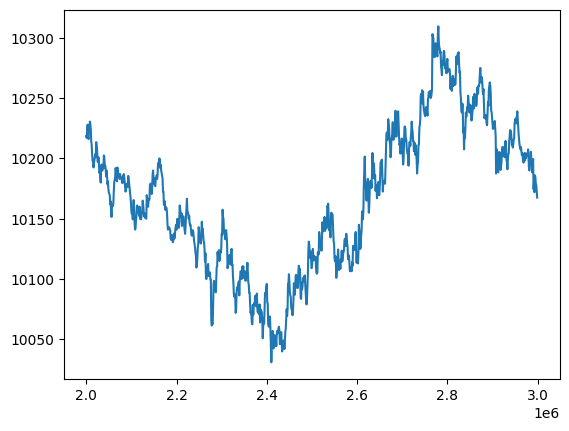

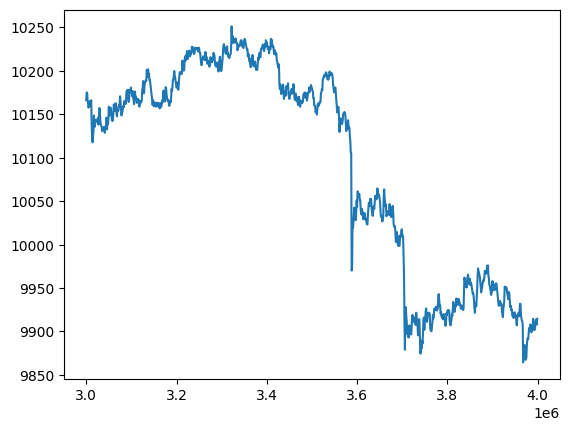

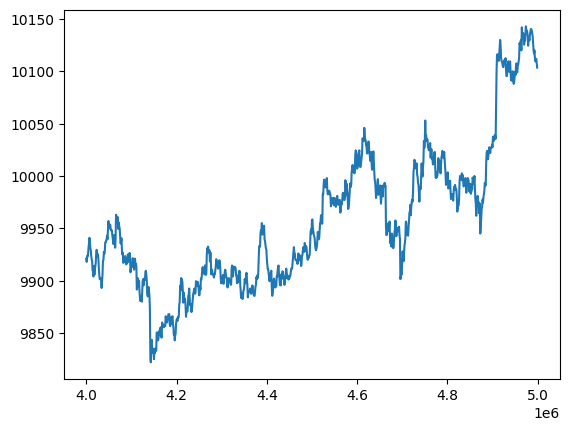

In [10]:
for S in symbols:
    for d in [2, 3, 4]:
        plot_prices(S, 1000000*d, 1000000*(d+1), 10)

A script to display all trades (satisfying certain criteria)

In [11]:
# shows all trades 
cur = df_trades[(df_trades['timestamp'] >= 3400000) & (df_trades['timestamp'] <= 3500000)]
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(cur[cur['symbol'] == VOR])

,timestamp,buyer,seller,symbol,currency,price,quantity,day
7446,3401200,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10228.0,9,3
7553,3405900,Pablo,Caesar,VOLCANIC_ROCK,SEASHELLS,10227.0,3,3
7554,3406100,Caesar,Pablo,VOLCANIC_ROCK,SEASHELLS,10222.0,1,3
7592,3407800,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10223.0,9,3
7692,3412000,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10230.0,5,3
7705,3412300,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10227.0,10,3
7708,3412500,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10227.0,10,3
7731,3413400,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10225.0,5,3
7752,3414400,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10224.0,9,3
7757,3415000,Caesar,Caesar,VOLCANIC_ROCK,SEASHELLS,10226.0,9,3


Self trades

In [12]:
# profile of self trades
cur = df_trades[df_trades['buyer'] == df_trades['seller']]
for T in traders:
    cur_T = cur[cur['buyer'] == T]
    print(T)
    print(cur_T)

Camilla
       timestamp    buyer   seller                symbol   currency  price  \
118      2008000  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  667.0   
309      2020500  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  649.0   
450      2029100  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  675.0   
716      2046600  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  603.0   
1261     2074600  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  639.0   
...          ...      ...      ...                   ...        ...    ...   
15969    4920700  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  742.0   
16110    4928700  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  729.0   
16444    4948200  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  773.0   
16559    4956600  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  753.0   
16904    4975900  Camilla  Camilla  MAGNIFICENT_MACARONS  SEASHELLS  747.0   

       quantity  day  
118           2    2  
309      

In [269]:
def show_all_trades(T='all', S=RAR, mode='all'):
    if (T == 'all'):
        cur = df_trades.copy(deep=True)
    else:
        cur = portfolios[T].copy(deep=True)
        if (mode == 'buy_only'):
            cur = cur[cur['buyer'] == T]
        if (mode == 'sell_only'):
            cur = cur[cur['seller'] == T]
    cur = cur[cur['symbol'] == S]
    with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.width', None):
        display(cur)

In [452]:
for T, A in [('Charlie', 'buy_only'), ('Caesar', 'sell_only')]:
    show_all_trades(T, MAC, A)

,timestamp,buyer,seller,symbol,currency,price,quantity,day
1280,2075600,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,641.0,2,2
6697,2361900,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,700.0,2,2
7580,2404900,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,657.0,2,2
7773,2415700,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,700.0,1,2
9283,2494900,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,700.0,2,2
11334,2614000,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,627.0,1,2
11785,2638900,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,586.0,1,2
12506,2679700,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,583.0,1,2
13248,2720800,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,651.0,1,2
14720,2803700,Charlie,Paris,MAGNIFICENT_MACARONS,SEASHELLS,596.0,1,2


,timestamp,buyer,seller,symbol,currency,price,quantity,day
886,2055800,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,573.0,4,2
2727,2159400,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,570.0,2,2
8969,2478000,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,735.0,5,2
11755,2637500,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,592.0,3,2
12315,2668300,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,573.0,3,2
14465,2789800,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,627.0,3,2
15279,2835200,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,643.0,3,2
15774,2862500,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,662.0,3,2
16393,2897800,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,654.0,2,2
103,3006200,Camilla,Caesar,MAGNIFICENT_MACARONS,SEASHELLS,643.0,5,3


Analyzing trader profile and symbol profile

In [17]:
def analyse_trader(T):
    print(T)
    for S in symbols:
        cur = portfolios[T]
        cur = cur[cur['symbol'] == S]
        S_buys = cur[cur['buyer'] == T]['quantity'].sum()
        S_sells = cur[cur['seller'] == T]['quantity'].sum()
        if (S_buys + S_sells > 0):
            print(S, S_buys, S_sells)

In [454]:
def temp():
    for T in traders:
        analyse_trader(T)
        print('-'*50)

In [177]:
def analyse_product(S):
    print(S)
    cur = df_trades[df_trades['symbol'] == S].copy(deep=True)
    for T in traders:
        cur_T_buy = cur[cur['buyer'] == T]['quantity'].sum()
        cur_T_sell = cur[cur['seller'] == T]['quantity'].sum()
        cur_T_self = cur[(cur['buyer'] == T) & (cur['seller'] == T)]['quantity'].sum()
        if (cur_T_buy + cur_T_sell > 0):
            print(T, cur_T_buy, cur_T_sell, cur_T_self)

In [453]:
def temp():
    for S in symbols:
        analyse_product(S)
        print('-'*50)

In [182]:
### Observations:
# vouchers: Caesar main seller, Camilla main buyer
# PB1, PB2: pretty even between Charlie, Caesar, Penelope, Pablo, Camilla
# DJE: Caesar and Paris. Camilla significant seller too
# CST: Caesar and Paris. Camilla significant seller too. Olivia insider
# SQI and KLP have very similar trade volumes and directions from each trader!!!!
#   how to utilize this??
# RAR: everyone pretty even. Little improvement available anyway
# JAM: Caesar, Camilla significant seller, Paris
# VOR: Caesar, Pablo, Peter. Caesar many self trades lol

In [54]:
print(portfolios['Gina'])

       timestamp    buyer   seller            symbol   currency    price  \
11       2000700  Charlie     Gina  RAINFOREST_RESIN  SEASHELLS   9997.0   
338      2021800     Gina  Charlie              KELP  SEASHELLS   2047.0   
349      2022600     Gina  Camilla              KELP  SEASHELLS   2047.0   
350      2022600     Gina  Charlie              KELP  SEASHELLS   2047.0   
351      2022600     Gina  Camilla         SQUID_INK  SEASHELLS   1794.0   
...          ...      ...      ...               ...        ...      ...   
17023    4981300    Pablo     Gina  RAINFOREST_RESIN  SEASHELLS   9997.0   
17163    4989300    Paris     Gina  RAINFOREST_RESIN  SEASHELLS   9997.0   
17193    4990600     Gina  Charlie  RAINFOREST_RESIN  SEASHELLS  10003.0   
17294    4996400  Charlie     Gina              KELP  SEASHELLS   2011.0   
17296    4996400     Gary     Gina         SQUID_INK  SEASHELLS   1917.0   

       quantity  day  
11            9    2  
338          10    2  
349           2   

### Strategy development goals:
- a stable round 3 strategy
- ~~squid ink short term mean reversion?~~ (not very rewarding...)
- round 4 get something done
- explore the similarity between KLP and SQI
- round 2 strategy refinement

count    29949.000000
mean        -0.086743
std          6.235808
min        -66.380000
25%         -3.220000
50%         -0.390000
75%          2.810000
max         69.620000
dtype: float64


<Axes: >

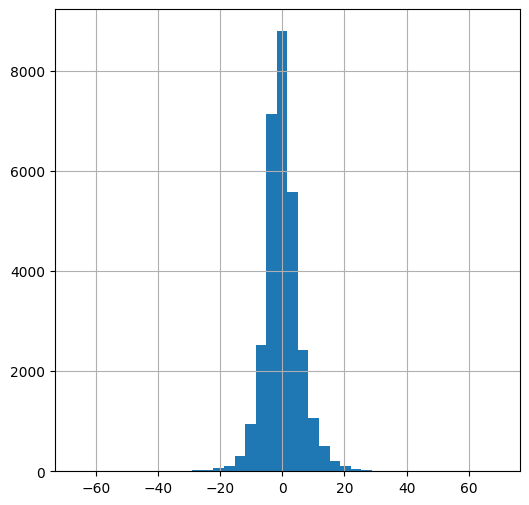

In [41]:
dur = 50

df = df_prices[df_prices['product'] == SQI][['timestamp', 'mid_price']]
df.set_index(['timestamp'], inplace=True)
df['MA'] = df['mid_price'].rolling(dur).mean()
print((df['MA'] - df['mid_price']).iloc[dur:-1].describe())
fig, ax = plt.subplots(figsize=(6,6))
(df['MA'] - df['mid_price']).hist(ax=ax, bins=40)

## Trader info research

Determine whether there is any statistically significant behaviour exhibited by the traders

In [83]:
def find_fortune_teller(T, action='buy'):
    cur = portfolios[T].copy(deep=True)
    if (action == 'buy'):
        cur = cur[cur['buyer'] == T]
    elif (action == 'sell'):
        cur = cur[cur['seller'] == T]
    for S in symbols:
        df = cur[cur['symbol'] == S]
        df2 = df_prices[df_prices['product'] == S]['mid_price']
        diff = []
        diff_past = []
        diff_future = []
        diff_future5 = []
        if (df.empty):
            continue
        for index, row in df.iterrows():
            t= (row['timestamp'] - 2000000) // 100
            if (t >= 30000 - 5):
                continue
            trade_price = row['price']
            mid_price = df2.iloc[t]
            trade_diff = trade_price - mid_price
            price_diff_past = df2.iloc[t] - df2.iloc[t-1]
            price_diff_future = df2.iloc[t+1] - df2.iloc[t]
            price_diff_future5 = df2.iloc[t+5] - df2.iloc[t]
            diff.append(trade_diff)
            diff_past.append(price_diff_past)
            diff_future.append(price_diff_future)
            diff_future5.append(price_diff_future5)
        df3 = pd.DataFrame({'trade': diff, 'past': diff_past, 'future': diff_future, 'future5': diff_future5})
        print('Trader', T, ' Product', S, 'Action', action)
        print(df3.describe())
        print('-'*50)

In [84]:
for T in traders:
    for action in {'buy', 'sell'}:
        find_fortune_teller(T, action)

Trader Camilla  Product PICNIC_BASKET1 Action buy
            trade        past      future     future5
count  489.000000  489.000000  489.000000  489.000000
mean    -3.776074   -0.947853    1.399796    1.903885
std      2.564828    4.887446    4.855724   10.014895
min     -9.500000  -18.000000  -11.500000  -24.000000
25%     -5.500000   -4.000000   -1.500000   -4.000000
50%     -5.000000   -1.000000    1.500000    1.000000
75%     -2.500000    2.500000    4.500000    8.500000
max      2.500000   17.500000   17.000000   28.000000
--------------------------------------------------
Trader Camilla  Product DJEMBES Action buy
       trade  past  future  future5
count    1.0   1.0     1.0      1.0
mean    -0.5   0.5     0.0      0.0
std      NaN   NaN     NaN      NaN
min     -0.5   0.5     0.0      0.0
25%     -0.5   0.5     0.0      0.0
50%     -0.5   0.5     0.0      0.0
75%     -0.5   0.5     0.0      0.0
max     -0.5   0.5     0.0      0.0
----------------------------------------------

In [81]:
def find_fortune_teller_refined(T_buy, T_sell):
    cur = portfolios[T_buy].copy(deep=True)
    cur = cur[(cur['seller'] == T_sell) & (cur['buyer'] == T_buy)]

    signals = []
    
    for S in symbols - {RAR}:
        df = cur[cur['symbol'] == S]
        df2 = df_prices[df_prices['product'] == S]['mid_price']
        diff = []
        diff_past = []
        diff_future = []
        diff_future5 = []
        if (df.empty):
            continue
        for index, row in df.iterrows():
            t= (row['timestamp'] - 2000000) // 100
            if (t >= 30000 - 5):
                continue
            trade_price = row['price']
            mid_price = df2.iloc[t]
            trade_diff = trade_price - mid_price
            price_diff_past = df2.iloc[t] - df2.iloc[t-1]
            price_diff_future = df2.iloc[t+1] - df2.iloc[t]
            price_diff_future5 = df2.iloc[t+5] - df2.iloc[t]
            diff.append(trade_diff)
            diff_past.append(price_diff_past)
            diff_future.append(price_diff_future)
            diff_future5.append(price_diff_future5)
        df3 = pd.DataFrame({'trade': diff, 'past': diff_past, 'future': diff_future, 'future5': diff_future5})
        print('Trader from', T_buy, 'to', T_sell, ': Product', S)
        for field in df3:
            if (field == 'trade'):
                continue
            z_score = df3[field].mean() / df3[field].std()
            if (abs(z_score) > 0.8 and df3[field].count() > 20):
                signals.append((T_buy, T_sell, S, field, z_score, df3[field].mean()))
                print('Trader from', T_buy, 'to', T_sell, ': Product', S)
                print(df3.describe())
                print('-'*50)
    return signals

In [455]:
alerts = []

for T1 in {'Camilla'}:
    for T2 in {'Caesar'}:
        alerts.extend(find_fortune_teller_refined(T1, T2))

Trader from Camilla to Caesar : Product KELP
Trader from Camilla to Caesar : Product VOLCANIC_ROCK_VOUCHER_9750
Trader from Camilla to Caesar : Product PICNIC_BASKET1
Trader from Camilla to Caesar : Product PICNIC_BASKET1
           trade      past     future    future5
count  31.000000  31.00000  31.000000  31.000000
mean    2.193548  -3.16129   3.403226   6.612903
std     0.247569   4.00705   3.832796  11.112088
min     2.000000 -13.00000  -3.500000 -22.000000
25%     2.000000  -5.00000   1.000000   0.000000
50%     2.000000  -3.00000   3.000000   6.500000
75%     2.500000  -0.75000   5.500000  14.500000
max     2.500000   3.50000  11.500000  24.000000
--------------------------------------------------
Trader from Camilla to Caesar : Product VOLCANIC_ROCK_VOUCHER_10000
Trader from Camilla to Caesar : Product VOLCANIC_ROCK_VOUCHER_9500
Trader from Camilla to Caesar : Product PICNIC_BASKET2
Trader from Camilla to Caesar : Product VOLCANIC_ROCK_VOUCHER_10250
Trader from Camilla to Caesa

In [83]:
alerts = sorted(alerts, key=lambda x: abs(x[4]), reverse=True)
for alert in alerts:
    print(alert)

('Gina', 'Charlie', 'KELP', 'future', -2.9155999595100885, -1.1734693877551021)
('Gina', 'Charlie', 'KELP', 'past', 2.7181995879782983, 1.0612244897959184)
('Pablo', 'Charlie', 'KELP', 'past', 2.409138621298456, 1.0333333333333334)
('Pablo', 'Charlie', 'KELP', 'future', -2.280350850198276, -1.0)
('Paris', 'Gary', 'KELP', 'past', 2.145866283052629, 1.1730769230769231)
('Charlie', 'Caesar', 'KELP', 'past', -2.1404999039918304, -1.0452830188679245)
('Paris', 'Camilla', 'JAMS', 'past', -2.085601714919303, -0.64)
('Paris', 'Gary', 'KELP', 'future', -2.070114759791943, -1.0961538461538463)
('Gina', 'Paris', 'KELP', 'future', -2.059766405213488, -1.0681818181818181)
('Gina', 'Charlie', 'KELP', 'future5', -2.005797862366434, -1.1020408163265305)
('Caesar', 'Gina', 'KELP', 'past', -1.8895316007756182, -1.3571428571428572)
('Caesar', 'Gina', 'KELP', 'future5', 1.8825199215044952, 1.6071428571428572)
('Charlie', 'Caesar', 'KELP', 'future', 1.8077391067133504, 1.069811320754717)
('Paris', 'Penelop

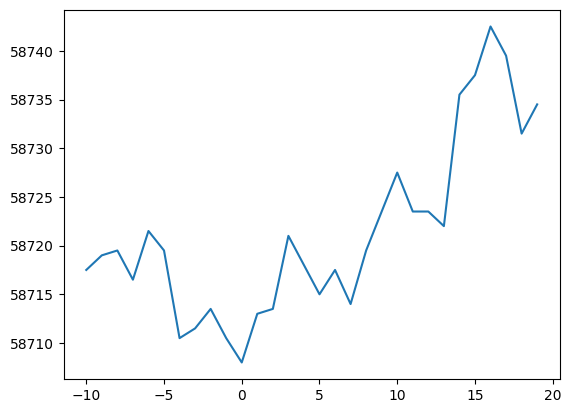

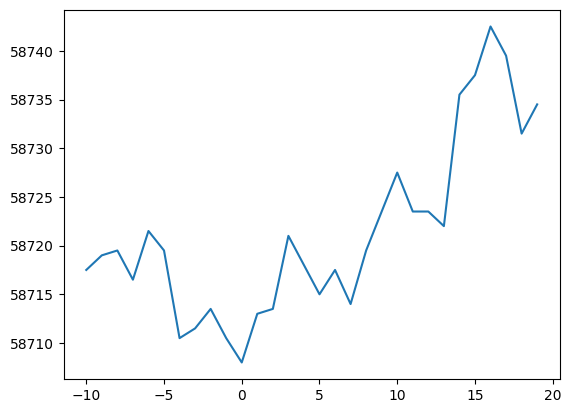

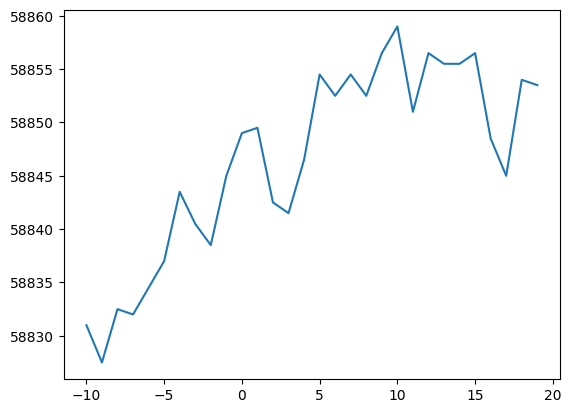

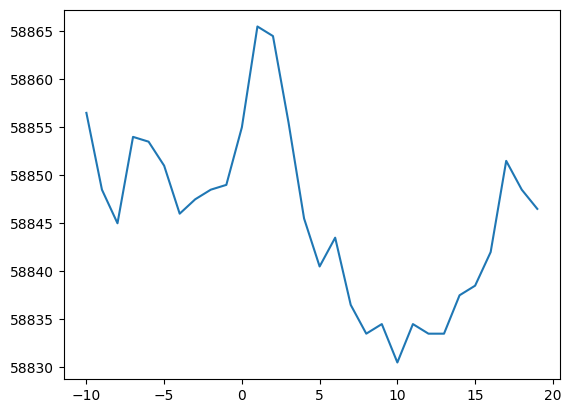

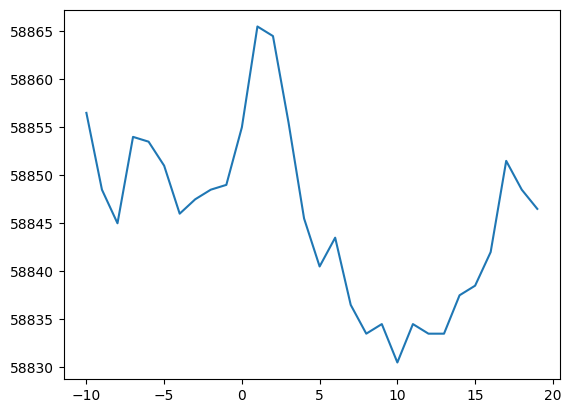

...

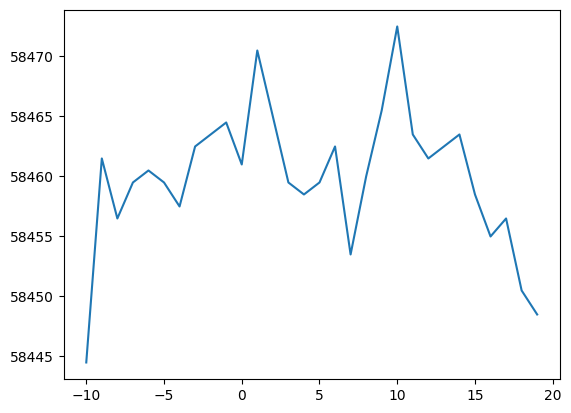

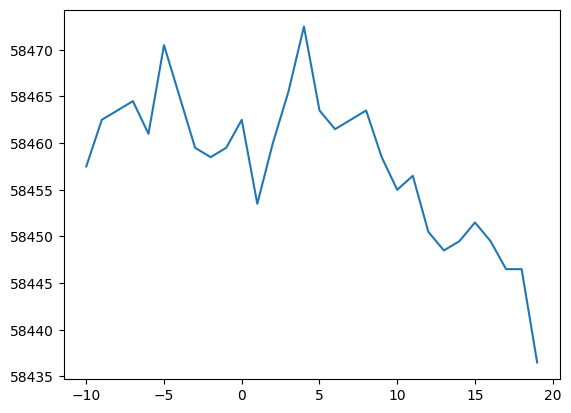

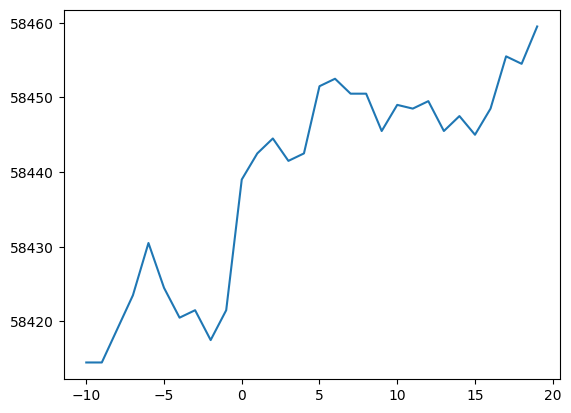

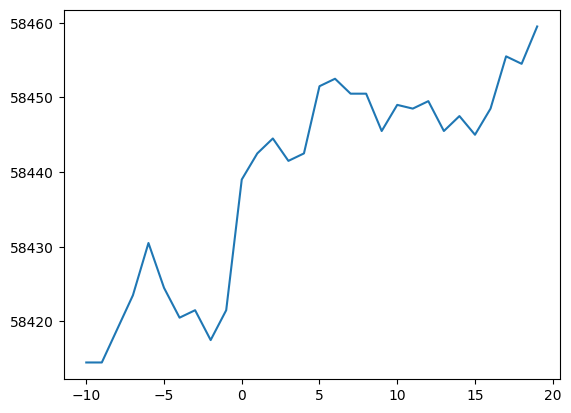

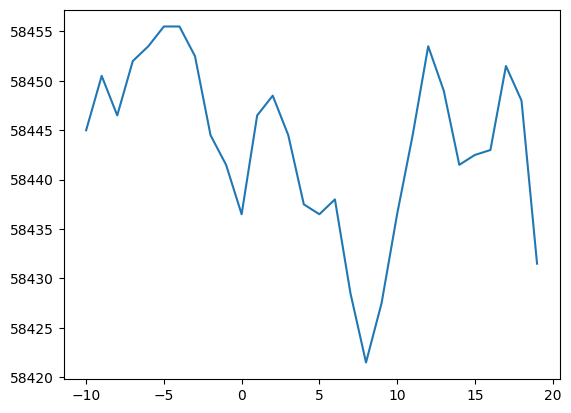

In [94]:
T = 'Pablo'
S = PB1
role = 'seller'

cur = portfolios[T].copy(deep=True)
cur = cur[cur[role] == T]
cur = cur[cur['symbol'] == S]

df2 = df_prices[df_prices['product'] == S]['mid_price']
for index, row in cur.iterrows():
    t = row['timestamp'] // 100 - 20000
    x = list(range(t-10, t+20))
    y = df2.iloc[x]
    x = list(range(-10, 20))
    plt.plot(x, y)
    plt.show()
    plt.close()

Observations:

Gina does especially badly at KLP and 
to a lesser extent) SQI.


Camilla

seems pretty willing to sell DJE, JAM, CST at floor(mid_price)
or meet market buys (I believe)
She's the main seller for PB1 (-3.7, 2.1) and PB2 (-1.7, 1.2)
Seems to have "market buy" and "market make" modes
SQI mode is (-1.5, +1.0)
KLP mode is (-1.5, +1.0)

Caesar

for PB1 (-3.2, 2.37), PB2 (-1.67, 1.07)
also an MM for Macarons
JAM compared to CST and DJE is a bit looser, mainly -1.0
surprisingly, bad buys for RAR
seems to have a spread for many items


Gina

KLP -- always bad trades?
SQI doesn't look like so by eyeballing

## Baskets research

In [15]:
index1 = prices[JAM] * 3 + prices[CST] * 6 + prices[DJE] - prices[PB1]
index2 = prices[JAM] * 2 + prices[CST] * 4 - prices[PB2]

In [17]:
def plot_indices(t1=2000000, t2=3000000, ticks=1):
    fig, ax = plt.subplots(2,1,figsize=(9,9))
    (index1.loc[t1: t2]).plot(ax=ax[0])
    ax[0].hlines(y=0, xmin=t1, xmax=t2, linewidth=2, color='black', linestyle='dotted')
    ax[0].set_title('PB1 index (+ve = long)')
    
    (index2.loc[t1: t2]).plot(ax=ax[1])
    ax[1].hlines(y=0, xmin=t1, xmax=t2, linewidth=2, color='black', linestyle='dotted')
    ax[1].set_title('PB2 index (+ve = long)')

Any statistical difference between movement towards zero and movement away from zero?

In [22]:
print(index1)

           mid_price
timestamp           
2000000       -136.0
2000100       -139.5
2000200       -144.5
2000300       -145.5
2000400       -138.5
...              ...
4999500        127.0
4999600        124.5
4999700        121.5
4999800        121.0
4999900        118.0

[30000 rows x 1 columns]


In [49]:
def investigate_revert_versus_deviate(I, D=100):
    revert = []
    deviate = []
    for i in range(D, 30000):
        pv_index = I.iloc[i-D]
        cur_index = I.iloc[i]
        if (pv_index < 0):
            if (cur_index > pv_index):
                revert.append(abs(cur_index - pv_index))
            else:
                deviate.append(abs(cur_index - pv_index))
        else:
            if (cur_index < pv_index):
                revert.append(abs(cur_index - pv_index))
            else:
                deviate.append(abs(cur_index - pv_index))
    df_revert = pd.DataFrame({'delta': revert})
    df_deviate = pd.DataFrame({'delta': deviate})
    print('revert:')
    print(df_revert.describe())
    print('-----------')
    print('deviate')
    print(df_deviate.describe())
    print('-----------')

In [51]:
investigate_revert_versus_deviate(index1['mid_price'], D=50)
investigate_revert_versus_deviate(index2['mid_price'], D=50)

revert:
              delta
count  15612.000000
mean      18.198213
std       13.483528
min        0.500000
25%        7.500000
50%       15.500000
75%       26.000000
max       91.500000
-----------
deviate
              delta
count  14338.000000
mean      16.940089
std       13.371515
min        0.000000
25%        6.500000
50%       14.000000
75%       24.500000
max       83.500000
-----------
revert:
              delta
count  14521.000000
mean      11.642001
std        8.632590
min        0.500000
25%        5.000000
50%       10.000000
75%       16.500000
max       46.500000
-----------
deviate
              delta
count  15429.000000
mean      10.582637
std        7.943711
min        0.000000
25%        4.000000
50%        9.000000
75%       15.500000
max       48.000000
-----------


<Axes: xlabel='timestamp'>

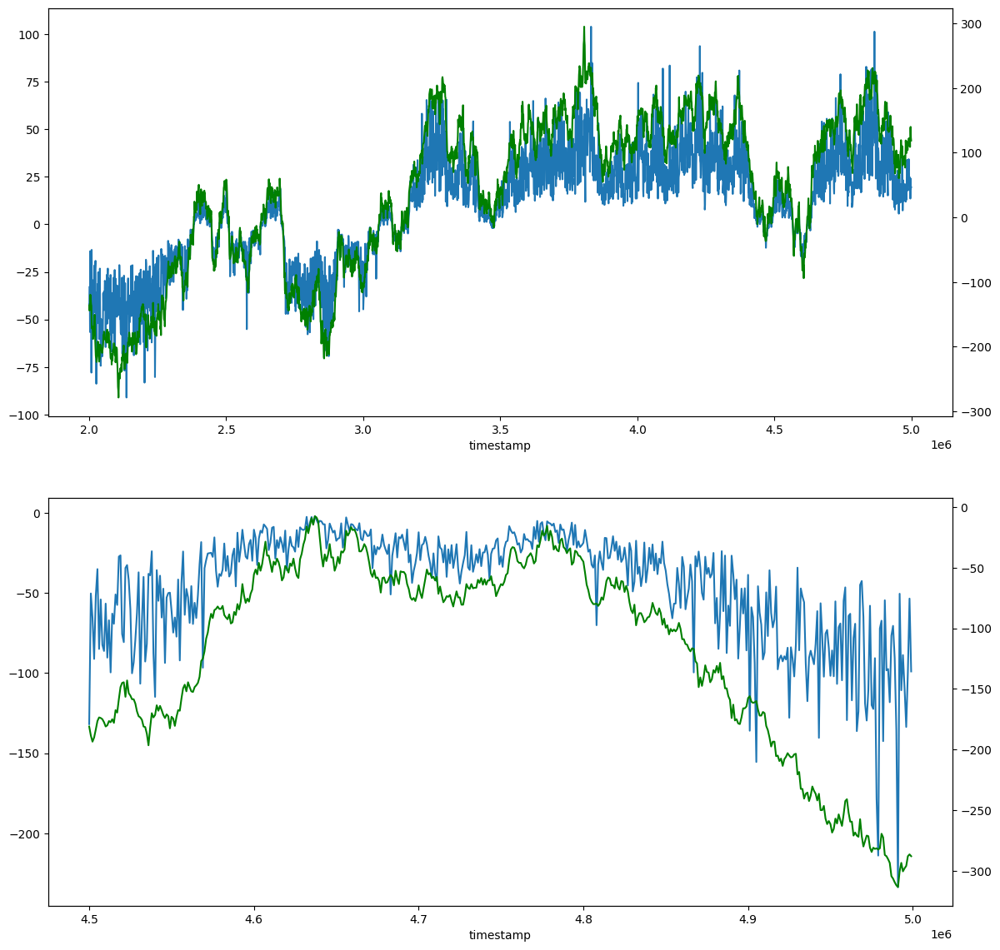

In [318]:
index1 = prices[JAM] * 3 + prices[CST] * 6 + prices[DJE] - prices[PB1]
index2 = prices[JAM] * 2 + prices[CST] * 4 - prices[PB2]

window = 15
vol1 = index1.rolling(window).std()
vol1.bfill(inplace=True)
vol2 = index2.rolling(window).std()
vol2.bfill(inplace=True)
index1['vol'] = vol1
index1['z_score'] = index1['mid_price'].div(index1['vol'])

fig, ax = plt.subplots(2,1,figsize=(14,14))
index1['z_score'].iloc[::10].plot(ax=ax[0])
ax0=ax[0].twinx()
index1['mid_price'].iloc[::10].plot(ax=ax0,color='g')

index2['vol'] = vol2
index2['z_score'] = index2['mid_price'].div(index2['vol'])
index2['z_score'].iloc[25000:30000:10].plot(ax=ax[1])
ax1=ax[1].twinx()
index2['mid_price'].iloc[25000:30000:10].plot(ax=ax1,color='g')

In [333]:
index1['D1'] = index1['mid_price'].shift(periods=-1) - index1['mid_price']
index1['D50'] = index1['mid_price'].shift(periods=-50) - index1['mid_price']
index1.ffill(inplace=True)

In [334]:
index1.describe()

,mid_price,vol,z_score,D1,D5,D50
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,38.258850,5.044645,8.572692,0.008367,0.043117,0.455483
std,120.398044,1.911569,28.696654,3.851648,7.433639,22.125951
min,-278.500000,1.183216,-106.622798,-15.500000,-29.500000,-91.500000
25%,-50.500000,3.650832,-10.017479,-2.500000,-5.000000,-14.000000
50%,63.500000,4.643480,12.184987,0.000000,0.000000,1.000000
75%,137.000000,6.007931,28.728219,2.500000,5.000000,15.500000
max,298.000000,17.569725,136.621523,15.500000,28.500000,83.500000


In [360]:
import statsmodels.api as sm

def predict(df, x_cols, y_col):
    X = df[x_cols]
    y = df[y_col]
    X = sm.add_constant(X)
    model = sm.OLS(y, X)
    res = model.fit()
    print(res.summary())
predict(index1[abs(index1['z_score']) > 50], ['z_score'], 'D50')
predict(index1[abs(index1['mid_price']) > 200], ['mid_price'], 'D50')

                            OLS Regression Results                            
Dep. Variable:                    D50   R-squared:                       0.052
Model:                            OLS   Adj. R-squared:                  0.051
Method:                 Least Squares   F-statistic:                     133.9
Date:                Mon, 21 Apr 2025   Prob (F-statistic):           3.35e-30
Time:                        09:41:15   Log-Likelihood:                -10991.
No. Observations:                2462   AIC:                         2.199e+04
Df Residuals:                    2460   BIC:                         2.200e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.3750      0.445     -3.090      0.0

**Conclusion: reversion force is stronger than deviation force!**

## Options research

In [95]:
## options research
for product in coupons:
    print(product)
    print(trades[product].describe())

VOLCANIC_ROCK_VOUCHER_9500
          timestamp        price     quantity          day
count  3.444000e+03  3444.000000  3444.000000  3444.000000
mean   3.520597e+06   570.224448    10.128339     3.026132
std    8.754554e+05   121.245027     5.484784     0.822224
min    2.003500e+06   311.000000     0.000000     2.000000
25%    2.762000e+06   448.000000     6.000000     2.000000
50%    3.497100e+06   601.000000    11.000000     3.000000
75%    4.312425e+06   676.000000    14.000000     4.000000
max    4.999500e+06   799.000000    20.000000     4.000000
VOLCANIC_ROCK_VOUCHER_9750
          timestamp        price     quantity          day
count  3.508000e+03  3508.000000  3508.000000  3508.000000
mean   3.516320e+06   325.985462    10.153934     3.021950
std    8.746275e+05   116.604169     5.491079     0.821251
min    2.003500e+06    98.000000     0.000000     2.000000
25%    2.762000e+06   206.000000     6.000000     2.000000
50%    3.496850e+06   356.000000    11.000000     3.000000
75

## Sunlight

In [89]:
def read_data():
    df_obs_1 = pd.read_csv('../round 4/data/observations_round_4_day_1.csv', sep=',')
    df_obs_2 = pd.read_csv('./data/observations_round_5_day_2.csv', sep=',')
    df_obs_3 = pd.read_csv('./data/observations_round_5_day_3.csv', sep=',')
    df_obs_4 = pd.read_csv('./data/observations_round_5_day_4.csv', sep=',')

    df_obs_1['timestamp'] = df_obs_1['timestamp'] + 1000000
    df_obs_2['timestamp'] = df_obs_2['timestamp'] + 2000000
    df_obs_3['timestamp'] = df_obs_3['timestamp'] + 3000000
    df_obs_4['timestamp'] = df_obs_4['timestamp'] + 4000000

    df_obs = pd.concat([df_obs_1, df_obs_2, df_obs_3, df_obs_4])
    df_obs.set_index(['timestamp'],inplace=True)

    return df_obs

In [449]:

for i in range(0, 40000, 1000):
    intervals = []
    for j in range(0, 1000):
        intervals.append(i+j)
    
    
    df_obs = read_data()
    
    fig, ax = plt.subplots(figsize=(15,10))
    df_obs['sunlightIndex'].iloc[intervals].plot(ax=ax,color='yellow')
    ax.grid(True)
    minor_ticks = np.arange(1000000, 5000000, 100000)
    ax.set_xticks(minor_ticks, minor=True)
    minor_ticks = np.arange(20, 70, 2)
    ax.set_yticks(minor_ticks, minor=True)
    ax.grid(which='minor', alpha=0.3)
    
    ax2 = ax.twinx()
    ax3 = ax.twinx()
    # df_obs['sugarPrice'].plot(ax=ax2,color='r')
    df_obs['bidPrice'].iloc[intervals].plot(ax=ax3,color='g')

    ax4 = ax.twinx()
    df_obs['exportTariff'].iloc[intervals].plot(ax=ax4, color='black')
    ax5 = ax.twinx()
    df_obs['importTariff'].iloc[intervals].plot(ax=ax5, color='b')
    ax6 = ax.twinx()
    df_obs['transportFees'].iloc[intervals].plot(ax=ax6, color='purple')

    plt.title('Price movement for' + str(i))
    
    imgname = './sunlight/' + str(i//1000+10) + '.jpg'
    plt.savefig(imgname)
    print(imgname + ' saved!')
    plt.close()

./sunlight/10.jpg saved!
./sunlight/11.jpg saved!
./sunlight/12.jpg saved!
./sunlight/13.jpg saved!
./sunlight/14.jpg saved!
./sunlight/15.jpg saved!
./sunlight/16.jpg saved!
./sunlight/17.jpg saved!
./sunlight/18.jpg saved!
./sunlight/19.jpg saved!
./sunlight/20.jpg saved!
./sunlight/21.jpg saved!
./sunlight/22.jpg saved!
./sunlight/23.jpg saved!
./sunlight/24.jpg saved!
./sunlight/25.jpg saved!
./sunlight/26.jpg saved!
./sunlight/27.jpg saved!
./sunlight/28.jpg saved!
./sunlight/29.jpg saved!
./sunlight/30.jpg saved!
./sunlight/31.jpg saved!
./sunlight/32.jpg saved!
./sunlight/33.jpg saved!
./sunlight/34.jpg saved!
./sunlight/35.jpg saved!
./sunlight/36.jpg saved!
./sunlight/37.jpg saved!
./sunlight/38.jpg saved!
./sunlight/39.jpg saved!
./sunlight/40.jpg saved!
./sunlight/41.jpg saved!
./sunlight/42.jpg saved!
./sunlight/43.jpg saved!
./sunlight/44.jpg saved!
./sunlight/45.jpg saved!
./sunlight/46.jpg saved!
./sunlight/47.jpg saved!
./sunlight/48.jpg saved!
./sunlight/49.jpg saved!


In [96]:
print(df_obs.describe())

           bidPrice      askPrice  transportFees  exportTariff  importTariff  \
count  40000.000000  40000.000000   40000.000000  40000.000000  40000.000000   
mean     696.210213    697.725163       1.585103      9.756113     -3.890250   
std       93.532880     93.533621       0.326898      0.996939      1.063718   
min      522.500000    524.000000       1.000000      7.000000     -6.000000   
25%      625.500000    627.000000       1.400000      9.000000     -4.625000   
50%      680.500000    682.250000       1.600000     10.000000     -3.500000   
75%      756.500000    758.000000       1.800000     10.500000     -3.000000   
max      990.000000    991.500000       2.100000     11.500000     -2.000000   

         sugarPrice  sunlightIndex  
count  40000.000000   40000.000000  
mean     204.444484      53.875500  
std        7.379699      10.762281  
min      191.684683      20.000000  
25%      198.096029      45.000000  
50%      203.019401      55.000000  
75%      210.857273 

In [99]:
def read_data_extra(df_prices):
    
    df_prices_1 = pd.read_csv('../round 4/data/prices_round_4_day_1.csv', sep=';')
    df_prices_1['timestamp'] = df_prices_1['day'] * 1000000 + df_prices_1['timestamp']
    df_prices_augment = pd.concat([df_prices_1, df_prices])
    return df_prices_augment

df_prices_augment = read_data_extra(df_prices)

In [101]:
df_prices_MAC = df_prices_augment[df_prices_augment['product'] == MAC]

        day  timestamp               product  bid_price_1  bid_volume_1  \
6         1    1000000  MAGNIFICENT_MACARONS        624.0          20.0   
29        1    1000100  MAGNIFICENT_MACARONS        627.0          14.0   
41        1    1000200  MAGNIFICENT_MACARONS        627.0          10.0   
47        1    1000300  MAGNIFICENT_MACARONS        629.0          14.0   
73        1    1000400  MAGNIFICENT_MACARONS        628.0          18.0   
...     ...        ...                   ...          ...           ...   
149938    4    4999500  MAGNIFICENT_MACARONS        742.0          10.0   
149946    4    4999600  MAGNIFICENT_MACARONS        738.0          12.0   
149955    4    4999700  MAGNIFICENT_MACARONS        742.0          18.0   
149978    4    4999800  MAGNIFICENT_MACARONS        741.0          10.0   
149988    4    4999900  MAGNIFICENT_MACARONS        739.0          16.0   

        bid_price_2  bid_volume_2  bid_price_3  bid_volume_3  ask_price_1  \
6             622.0   

In [149]:
def investigate_sunlight_index():
    cluster = []
    for i in range(100, 39900):
        diff_pv = df_obs['sunlightIndex'].iloc[i] - df_obs['sunlightIndex'].iloc[i-20]
        diff_fut = df_obs['sunlightIndex'].iloc[i+20] - df_obs['sunlightIndex'].iloc[i]
        if (abs(diff_pv - diff_fut) >= 0.03):
            cluster.append(i)
        elif (len(cluster) > 0):
            print(np.mean(cluster))
            cluster = []

Conclusion: Sunlight Index slope changes at multiples of 100000 timestamps

In [122]:
from sklearn.linear_model import LinearRegression

cols = ['bidPrice', 'askPrice', 'transportFees', 'exportTariff', 'importTariff', 'sugarPrice', 'sunlightIndex']
reg = LinearRegression().fit(X, y)
reg.score(X, y)

0.9999991711546239

In [239]:
print(df_obs)

           bidPrice  askPrice  transportFees  exportTariff  importTariff  \
timestamp                                                                  
1000000       627.0     628.5            1.0           9.0          -3.0   
1000100       630.0     631.5            1.0           9.0          -3.0   
1000200       630.0     631.5            1.0           9.0          -3.0   
1000300       632.0     633.5            1.0           9.0          -3.0   
1000400       630.5     632.0            1.0           9.0          -3.0   
...             ...       ...            ...           ...           ...   
4999500       745.0     746.5            1.6           7.5          -4.0   
4999600       741.0     742.5            1.6           7.5          -4.0   
4999700       744.5     746.0            1.6           7.5          -4.0   
4999800       744.0     745.5            1.6           7.5          -4.0   
4999900       742.0     743.5            1.6           7.5          -4.0   

           

In [261]:
def engineer_features(df_obs):
    ret = df_obs.copy(deep=True)
    # a feature on (average price in next T days - current price)
    for T in [1, 20, 100]:
        MA = df_obs['bidPrice'].rolling(T+1).mean().shift(periods=-T) - df_obs['bidPrice']
        ret['MA_'+str(T)] = MA
    # a feature to capture (gradually) changes in the tariffs and fees
    for feature in ['transportFees', 'exportTariff', 'importTariff']:
        T=3
        MA = df_obs[feature].rolling(T+1).mean() - df_obs[feature]
        ret[feature+'_change'] = MA
    
    # remove the effect of tariffs and fees. R^2 = ~0.4
    ret['normalizedPrice'] = ret['bidPrice'] +44.0625 * ret['exportTariff'] + 46.7397 * ret['importTariff'] + 33.9310 * ret['transportFees']

    # a feature using the periodicity of sunlight index change
    ret['distanceToStart'] = ret.index % 100000
    ret['distanceToEnd'] = 100000 - ret['distanceToStart']
    
    def f(I, CSI, DTS):
        # I: series of sunlight index
        # CSI: threshold CSI
        # DTS: distance to start. models uncertainty?
        values = [0] * 40000
        return values
    
    for CSI in range(40, 51):
        # 0.0 means not affected, 1.0 means super affected
        ret['CSI_'+CSI] = f(df_obs['sunlightIndex'], CSI, ret['distanceToStart'])
    T=500
    ret['VOL'] = df_obs['bidPrice'].pct_change().rolling(T).std() * 100
    # remove the NA values
    ret.ffill(inplace=True)
    ret.bfill(inplace=True)
    return ret
df_obs_augment = engineer_features(df_obs)

In [255]:
print(df_obs_augment.describe())

           bidPrice      askPrice  transportFees  exportTariff  importTariff  \
count  40000.000000  40000.000000   40000.000000  40000.000000  40000.000000   
mean     696.210213    697.725163       1.585103      9.756113     -3.890250   
std       93.532880     93.533621       0.326898      0.996939      1.063718   
min      522.500000    524.000000       1.000000      7.000000     -6.000000   
25%      625.500000    627.000000       1.400000      9.000000     -4.625000   
50%      680.500000    682.250000       1.600000     10.000000     -3.500000   
75%      756.500000    758.000000       1.800000     10.500000     -3.000000   
max      990.000000    991.500000       2.100000     11.500000     -2.000000   

         sugarPrice  sunlightIndex          MA_1         MA_20        MA_100  \
count  40000.000000   40000.000000  40000.000000  40000.000000  40000.000000   
mean     204.444484      53.875500      0.001412      0.028148      0.182695   
std        7.379699      10.762281     

In [237]:
import statsmodels.api as sm

def predict(df, x_cols, y_col):
    X = df[x_cols]
    y = df[y_col]
    X = sm.add_constant(X)
    model = sm.OLS(y, X)
    res = model.fit()
    print(res.summary())

In [246]:
def generate_predictions():
    '''
    for feature in ['transportFees', 'exportTariff', 'importTariff']:
        df_zero = df_obs_augment[df_obs_augment[feature+'_change'] == 0]
        df_delta = df_obs_augment[df_obs_augment[feature+'_change'] != 0]
        predict(df_delta, [str(feature+'_change')], 'MA_20')
    predict(df_obs_augment, ['distanceToStart', 'distanceToEnd'], 'MA_20')
    predict(df_obs_augment, ['sunlightIndex'], 'normalizedPrice')
    predict(df_obs_augment, ['sunlightIndex'], 'bidPrice')
    '''
    # using sunlightIndex alone is like R^2 = 0.3 on the price
generate_predictions()

Observations:
- bidPrice -> future price movement is essentially noise (nice!)
- importTariff, exportTariff, transportFees each affect the bidPrice by around -(30~40).
- The effect seems to be immediate. The market is rather efficient! (but that also means I don't really have a way to exploit that...)

<Axes: xlabel='timestamp'>

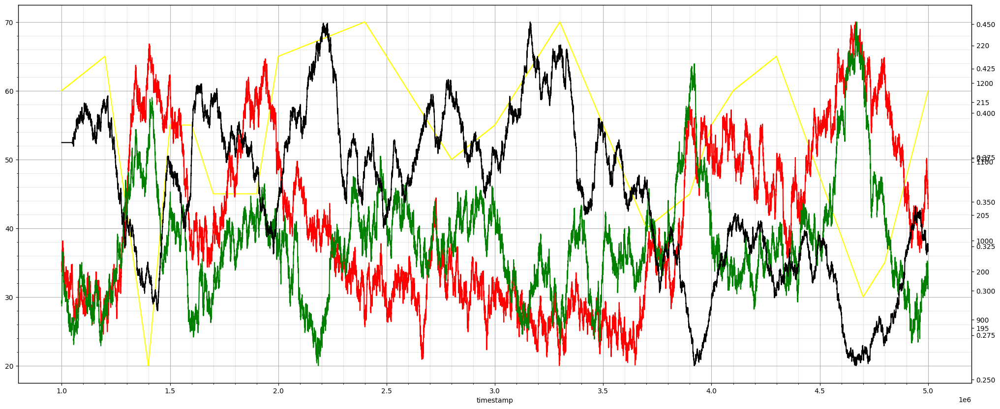

<Axes: xlabel='timestamp'>

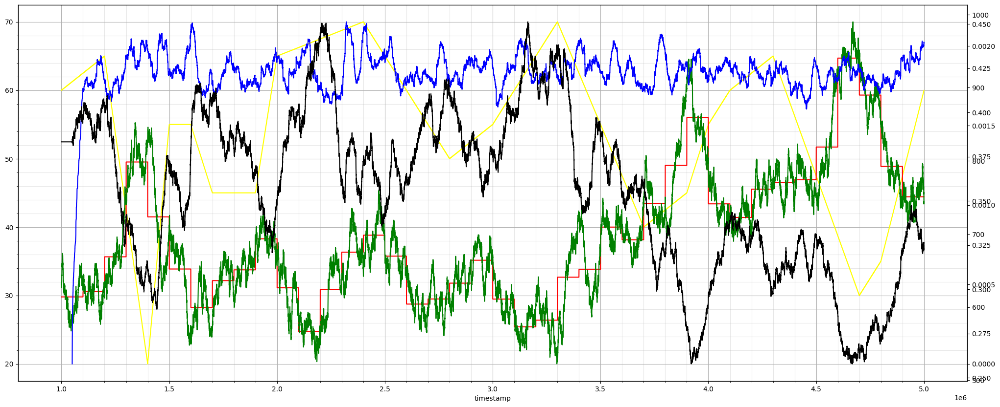

In [458]:
fig, ax = plt.subplots(figsize=(25,10))
df_plot = df_obs_augment.iloc[:]

# U = 'normalizedPrice'
U = 'bidPrice'

i1 = 0
i2 = 1000
mean = df_obs_augment[U].iloc[i1:i2].mean()
val = [mean] * 1000
for t in range(40000):
    if (t == i2):
        i1 += 1000
        i2 += 1000
        mean = df_obs_augment[U].iloc[i1:i2].mean()
        val.extend([mean] * 1000)

df_plot['intervalMean'] = val
df_plot['sunlightIndex'].plot(ax=ax,color='yellow')
ax.grid(True)
minor_ticks = np.arange(1000000, 5000000, 100000)
ax.set_xticks(minor_ticks, minor=True)
minor_ticks = np.arange(20, 70, 2)
ax.set_yticks(minor_ticks, minor=True)

ax.grid(which='minor', alpha=0.3)
ax2 = ax.twinx()
ax3 = ax.twinx()
df_plot['intervalMean'].plot(ax=ax2,color='r')
df_plot[U].plot(ax=ax2,color='g')
# df_plot['bidPrice'].plot(ax=ax3,color='blue')
ax4 = ax.twinx()
df_plot['VOL'].plot(ax=ax4, color='black')

T=500
df_plot['VOLVOL'] = df_plot['VOL'].pct_change().rolling(T).std()
df_plot['VOLVOL'].plot(ax=ax3, color='blue')

In [408]:
print(df_plot.describe())

           bidPrice      askPrice  transportFees  exportTariff  importTariff  \
count  40000.000000  40000.000000   40000.000000  40000.000000  40000.000000   
mean     696.210213    697.725163       1.585103      9.756113     -3.890250   
std       93.532880     93.533621       0.326898      0.996939      1.063718   
min      522.500000    524.000000       1.000000      7.000000     -6.000000   
25%      625.500000    627.000000       1.400000      9.000000     -4.625000   
50%      680.500000    682.250000       1.600000     10.000000     -3.500000   
75%      756.500000    758.000000       1.800000     10.500000     -3.000000   
max      990.000000    991.500000       2.100000     11.500000     -2.000000   

         sugarPrice  sunlightIndex          MA_1         MA_20        MA_100  \
count  40000.000000   40000.000000  40000.000000  40000.000000  40000.000000   
mean     204.444484      53.875500      0.001412      0.028148      0.182695   
std        7.379699      10.762281     

array([[<Axes: title={'center': 'D'}>]], dtype=object)

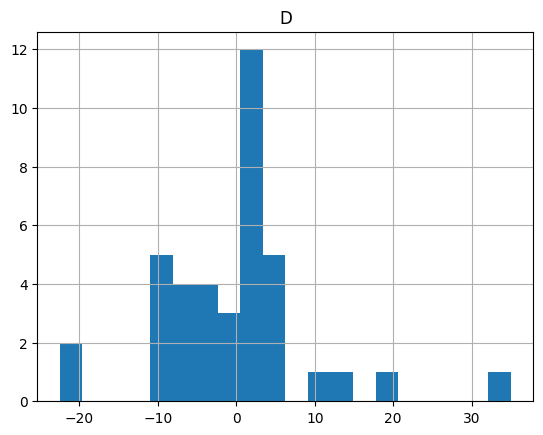

In [393]:
SI_diff = []
for t in range(0, 39000, 1000):
    SI_diff.append(df_obs_augment['sunlightIndex'].iloc[t+1000] - df_obs_augment['sunlightIndex'].iloc[t])

pd.DataFrame({'D': SI_diff}).hist(bins=20)

In [134]:
df_prices_MAC.set_index(['timestamp'], inplace=True)

In [266]:
print(df_prices_MAC)

           day               product  bid_price_1  bid_volume_1  bid_price_2  \
timestamp                                                                      
1000000      1  MAGNIFICENT_MACARONS        624.0          20.0        622.0   
1000100      1  MAGNIFICENT_MACARONS        627.0          14.0        625.0   
1000200      1  MAGNIFICENT_MACARONS        627.0          10.0        625.0   
1000300      1  MAGNIFICENT_MACARONS        629.0          14.0        627.0   
1000400      1  MAGNIFICENT_MACARONS        628.0          18.0        625.0   
...        ...                   ...          ...           ...          ...   
4999500      4  MAGNIFICENT_MACARONS        742.0          10.0        740.0   
4999600      4  MAGNIFICENT_MACARONS        738.0          12.0        736.0   
4999700      4  MAGNIFICENT_MACARONS        742.0          18.0        740.0   
4999800      4  MAGNIFICENT_MACARONS        741.0          10.0        739.0   
4999900      4  MAGNIFICENT_MACARONS    

In [267]:
for field in {'importTariff', 'exportTariff', 'transportFees'}:
    L = []
    for t in range(1, 40000):
        if (df_obs_augment[field].iloc[t] != df_obs_augment[field].iloc[t-1]):
            L.append(t)
    print(field)
    print(L)
    print('-'*50)

exportTariff
[13, 548, 809, 1274, 2558, 4061, 4071, 4437, 4467, 5511, 5760, 6080, 6791, 10612, 10893, 10933, 11348, 14042, 14305, 14444, 15481, 16179, 20108, 20243, 21823, 24290, 24863, 25666, 26138, 27029, 27840, 28520, 29298, 29310, 29923, 31771, 33558, 36176, 37032, 37333, 37636, 39142, 39695]
--------------------------------------------------
importTariff
[2999, 6921, 7086, 7626, 8923, 9397, 10126, 12195, 13866, 13947, 14551, 15697, 16255, 19148, 20606, 22997, 23679, 24048, 24311, 24806, 25946, 26209, 27988, 30308, 33252, 33467, 34048, 34177, 36317, 37134, 37342, 39964]
--------------------------------------------------
transportFees
[3043, 3093, 4038, 7992, 8045, 8290, 8561, 9379, 9504, 9606, 10048, 10153, 11008, 11095, 12519, 12593, 12965, 13185, 13512, 13746, 14275, 14388, 15420, 16547, 16911, 17083, 17525, 17928, 18173, 18278, 18943, 18992, 19163, 19531, 19538, 20518, 21003, 21302, 22545, 22551, 23139, 23391, 23569, 23905, 25292, 25310, 26542, 26557, 27115, 28602, 29117, 30000,

In [275]:
def show_all_trade_times(T='all', S=RAR, mode='all'):
    if (T == 'all'):
        cur = df_trades.copy(deep=True)
    else:
        cur = portfolios[T].copy(deep=True)
        if (mode == 'buy_only'):
            cur = cur[cur['buyer'] == T]
        if (mode == 'sell_only'):
            cur = cur[cur['seller'] == T]
    cur = cur[cur['symbol'] == S]
    print('Trader', T, mode)
    with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.width', None):
        display(cur['timestamp'])
for T in traders:
    for action in {'buy_only', 'sell_only'}:
        show_all_trade_times(T, MAC, action)

Trader Caesar buy_only


23       2001500
132      2009400
398      2025700
560      2035400
827      2052000
885      2055700
1004     2060100
1142     2067800
1163     2069100
1279     2075600
1507     2088500
1765     2102700
1849     2107500
1917     2111600
2133     2125300
2174     2127800
2345     2136800
2368     2138100
2470     2144000
2803     2163200
2929     2171800
2995     2173900
3482     2200100
3629     2207100
3721     2211400
3834     2216400
4158     2233200
4189     2235100
4946     2272900
5052     2278400
5131     2283100
5173     2285400
5308     2294400
5348     2296000
5472     2302100
6038     2330300
6059     2331200
6094     2332400
6696     2361900
6898     2370500
7008     2375900
7125     2382900
7288     2390000
7556     2404000
7579     2404900
7593     2405700
7618     2407300
7772     2415700
7804     2417800
8027     2430000
8637     2462000
8828     2471500
8848     2472500
8851     2472600
8893     2474800
8914     2475500
9040     2480900
9069     2482900
9097     24844

Trader Caesar sell_only


886      2055800
2727     2159400
8969     2478000
11755    2637500
12315    2668300
14465    2789800
15279    2835200
15774    2862500
16393    2897800
103      3006200
753      3041700
1180     3062800
2387     3130400
4844     3256400
7350     3396100
10427    3557900
12472    3671000
12695    3684300
15917    3883900
17226    3963400
17836    3998300
2589     4147500
4809     4280000
10310    4593300
14341    4828300
14602    4842400
15522    4895900
15734    4906600
Name: timestamp, dtype: int64

Trader Penelope buy_only


Series([], Name: timestamp, dtype: int64)

Trader Penelope sell_only


Series([], Name: timestamp, dtype: int64)

Trader Gina buy_only


Series([], Name: timestamp, dtype: int64)

Trader Gina sell_only


Series([], Name: timestamp, dtype: int64)

Trader Charlie buy_only


1280     2075600
6697     2361900
7580     2404900
7773     2415700
9283     2494900
11334    2614000
11785    2638900
12506    2679700
13248    2720800
14720    2803700
14833    2810100
16083    2880300
16104    2881300
17011    2933100
17714    2973200
1782     3097900
2327     3127200
2612     3141700
5086     3270800
6254     3338000
9936     3529700
11082    3593500
13917    3760200
15665    3866100
15727    3872000
16043    3891400
515      4029000
632      4034900
1187     4070200
2174     4124700
2968     4167200
4664     4271700
7207     4417200
8171     4471200
11987    4693800
12548    4725100
12639    4729600
13423    4775900
14883    4859500
Name: timestamp, dtype: int64

Trader Charlie sell_only


31       2002400
120      2008600
223      2015200
241      2016500
255      2017900
347      2022400
659      2042900
740      2048200
807      2050700
1272     2075200
1283     2075800
1310     2077200
1339     2079800
1573     2091300
1711     2100000
1712     2100100
1723     2101100
1847     2107200
2055     2119600
2251     2131900
2325     2135400
2442     2142900
2721     2158900
2735     2159900
3034     2176700
3093     2179900
3378     2193300
3554     2203000
3828     2215700
4047     2226600
4126     2231500
4311     2240800
4428     2246500
4622     2257500
4837     2267300
4871     2268600
5005     2275700
5109     2281700
5149     2284500
5281     2293300
5478     2302500
5975     2326800
5991     2327400
6143     2334800
6151     2335200
6169     2336000
6320     2345600
6335     2345800
6451     2351300
6567     2355700
6576     2356000
6849     2367700
6887     2369600
6902     2370800
7028     2377300
7171     2384800
7660     2410200
7763     2415400
7866     24217

Trader Camilla buy_only


118      2008000
309      2020500
450      2029100
716      2046600
883      2055400
886      2055800
1261     2074600
1663     2096600
1698     2099000
1866     2108500
2333     2136500
2354     2137200
2727     2159400
3101     2180300
3539     2202400
3802     2214200
4516     2251200
4588     2254900
4867     2268300
5441     2300400
5612     2308500
6066     2331300
6278     2343500
6344     2346600
6368     2348000
6449     2351200
7900     2423900
8389     2449400
8430     2450700
8552     2458100
8782     2469700
8889     2474600
8969     2478000
9060     2482600
9210     2491600
9613     2512300
9698     2518000
10660    2576600
10689    2577500
10770    2582300
10860    2587800
10861    2587900
11297    2611400
11421    2618500
11755    2637500
11912    2647100
12008    2653100
12175    2662500
12188    2663200
12315    2668300
12328    2669300
12432    2676300
12581    2684600
12705    2691200
12782    2694000
12981    2705800
13197    2718200
13615    2739700
13717    27463

Trader Camilla sell_only


118      2008000
309      2020500
450      2029100
716      2046600
1261     2074600
1663     2096600
1698     2099000
1849     2107500
1866     2108500
2333     2136500
2354     2137200
3101     2180300
3539     2202400
3802     2214200
4516     2251200
4588     2254900
4867     2268300
5441     2300400
5612     2308500
6066     2331300
6259     2342200
6278     2343500
6344     2346600
6368     2348000
6449     2351200
7900     2423900
8027     2430000
8389     2449400
8430     2450700
8552     2458100
8782     2469700
8889     2474600
9060     2482600
9210     2491600
9613     2512300
9698     2518000
10660    2576600
10770    2582300
10860    2587800
10861    2587900
11297    2611400
11421    2618500
11912    2647100
12008    2653100
12175    2662500
12188    2663200
12328    2669300
12402    2675100
12432    2676300
12581    2684600
12705    2691200
12782    2694000
12981    2705800
13197    2718200
13615    2739700
13717    2746300
14219    2775200
14447    2789000
14456    27896

Trader Gary buy_only


Series([], Name: timestamp, dtype: int64)

Trader Gary sell_only


Series([], Name: timestamp, dtype: int64)

Trader Pablo buy_only


Series([], Name: timestamp, dtype: int64)

Trader Pablo sell_only


Series([], Name: timestamp, dtype: int64)

Trader Peter buy_only


Series([], Name: timestamp, dtype: int64)

Trader Peter sell_only


Series([], Name: timestamp, dtype: int64)

Trader Olivia buy_only


Series([], Name: timestamp, dtype: int64)

Trader Olivia sell_only


Series([], Name: timestamp, dtype: int64)

Trader Paris buy_only


31       2002400
120      2008600
167      2012100
223      2015200
241      2016500
255      2017900
347      2022400
659      2042900
740      2048200
807      2050700
1272     2075200
1283     2075800
1310     2077200
1339     2079800
1573     2091300
1711     2100000
1712     2100100
1723     2101100
1847     2107200
2055     2119600
2251     2131900
2325     2135400
2442     2142900
2721     2158900
2735     2159900
3034     2176700
3093     2179900
3378     2193300
3554     2203000
3828     2215700
4047     2226600
4126     2231500
4311     2240800
4428     2246500
4622     2257500
4837     2267300
4871     2268600
5005     2275700
5109     2281700
5149     2284500
5281     2293300
5478     2302500
5975     2326800
5991     2327400
6143     2334800
6151     2335200
6169     2336000
6259     2342200
6320     2345600
6335     2345800
6451     2351300
6544     2354900
6567     2355700
6576     2356000
6849     2367700
6887     2369600
6902     2370800
7028     2377300
7171     23848

Trader Paris sell_only


23       2001500
132      2009400
167      2012100
398      2025700
560      2035400
827      2052000
883      2055400
885      2055700
1004     2060100
1142     2067800
1163     2069100
1279     2075600
1280     2075600
1507     2088500
1765     2102700
1917     2111600
2133     2125300
2174     2127800
2345     2136800
2368     2138100
2470     2144000
2803     2163200
2929     2171800
2995     2173900
3482     2200100
3629     2207100
3721     2211400
3834     2216400
4158     2233200
4189     2235100
4946     2272900
5052     2278400
5131     2283100
5173     2285400
5308     2294400
5348     2296000
5472     2302100
6038     2330300
6059     2331200
6094     2332400
6544     2354900
6696     2361900
6697     2361900
6898     2370500
7008     2375900
7125     2382900
7288     2390000
7556     2404000
7579     2404900
7580     2404900
7593     2405700
7618     2407300
7772     2415700
7773     2415700
7804     2417800
8548     2457800
8637     2462000
8828     2471500
8848     24725

Trader Olga buy_only


Series([], Name: timestamp, dtype: int64)

Trader Olga sell_only


Series([], Name: timestamp, dtype: int64)

In [370]:
# any arb opportunities?
foreign_buy_price = df_obs['askPrice'] - df_obs['importTariff'] + df_obs['transportFees']
foreign_sell_price = df_obs['bidPrice'] - df_obs['exportTariff'] - df_obs['transportFees']

# negative means arb
print((foreign_buy_price - df_prices_MAC['ask_price_1']).describe())
# positive means arb
print((foreign_sell_price - df_prices_MAC['bid_price_1']).describe())

count    40000.000000
mean         2.231390
std          1.337418
min         -0.100000
25%          1.100000
50%          1.800000
75%          3.200000
max          9.800000
dtype: float64
count    40000.000000
mean        -8.094803
std          1.090363
min        -15.200000
25%         -8.600000
50%         -8.100000
75%         -7.500000
max         -5.700000
dtype: float64


In [372]:
print((df_prices_MAC['ask_price_1'] - df_prices_MAC['bid_price_1']).describe())

count    40000.000000
mean         8.005325
std          1.208380
min          2.000000
25%          8.000000
50%          8.000000
75%          9.000000
max         10.000000
dtype: float64
